In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os

import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, Dataset


from scipy.stats import multivariate_normal as mvn
from matplotlib import cm

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [ ]:
class CelebADataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image



# Define transformations (e.g., resize, normalize)
transform = transforms.Compose([
    transforms.Resize((218, 178)),
    transforms.ToTensor(),
])

# Load dataset from directory containing subdirectories of images
dataset = CelebADataset(image_dir='D:\\CelebA\\img_align_celeba\\img_align_celeba\\', transform=transform)
train_loader = DataLoader(dataset, batch_size=64, shuffle=True)


In [ ]:

class autoencoder(nn.Module):
    def __init__(self, encoder_params, decoder_params):
        super(autoencoder, self).__init__()
        self.latent_dim = decoder_params[0][0]
                
        # Encoder
        encoder_modules = []
        for params in encoder_params:
            in_channels, out_channels, kernel_size, stride, padding, dilation = params

            encoder_modules.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, dilation=dilation),
                    nn.BatchNorm2d(out_channels),
                    nn.ReLU()
                )
            )

        self.encoder = nn.Sequential(*encoder_modules)

        # Decoder
        decoder_modules = []
        for i, params in enumerate(decoder_params[:-1]):
            in_channels, out_channels, kernel_size, stride, padding, output_padding, dilation = params


            decoder_modules.append(
                nn.Sequential(
                    nn.ConvTranspose2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, output_padding=output_padding, dilation=dilation),
                    nn.BatchNorm2d(out_channels),
                    nn.ReLU()
                )
            )

        in_channels, out_channels, kernel_size, stride, padding, output_padding, dilation = decoder_params[-1]
        decoder_modules.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, output_padding=output_padding, dilation=dilation))

        self.decoder = nn.Sequential(*decoder_modules)
        
    def reparameterize(self, mu, logvar):#
        std = torch.exp(.5*logvar)#
        eps = torch.randn_like(std)#
        
        return mu + std*eps#
        
    def forward(self, x):
        h = self.encoder(x)
        # mu, logvar = h[:,:self.latent_dim], h[:, self.latent_dim:]#
        # z = self.reparameterize(mu, logvar)#
        return self.decoder(h)#, mu, logvar

    def loss(self, reconstructed_x, x):#, mu, log_var):
        
        mse_loss =  F.mse_loss(reconstructed_x, x)

        # kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())#
        
        return mse_loss #+ kl_loss
            
        


In [17]:
#in_channels, out_channels, kernel_size, stride, padding, dilation
encoder_params = [
    (3, 32, [3, 3], [2, 2], [0, 0], [1, 1]), 
    (32, 64, [4, 8], [2, 2], [0, 0], [1, 1]),
    (64, 128, [2, 2], [2, 2], [0, 0], [2, 2]),
    (128, 256, [3, 3], [3, 3], [0, 0], [2, 2]),
    (256, 512, [8, 6], [1, 1], [0, 0], [1, 1])
]


# out_channels, kernel_size, stride, padding, output_padding, dilation
decoder_params = [
    (512,512,[8, 6], [1, 1], [0, 0], [0, 0], [1, 1]),
    (512,256,[3, 3], [3, 3], [0, 0], [0, 0], [2, 2]),
    (256,128,[2, 2], [2, 2], [0, 0], [0, 0], [2, 2]),
    (128,64,[4, 8], [2, 2], [0, 0], [0, 0], [1, 1]),
    (64,3,[3, 3], [2, 2], [0, 0], [1, 1], [1, 1]),
] 

# initialize model
model = autoencoder(encoder_params, decoder_params).to(device)

In [ ]:
# Define the optimizer
learning_rate = 1e-3
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [19]:
model.encoder

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (1): Sequential(
    (0): Conv2d(32, 64, kernel_size=(4, 8), stride=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(2, 2), stride=(2, 2), dilation=(2, 2))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(3, 3), dilation=(2, 2))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(8, 6), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
)

In [20]:
model.decoder

Sequential(
  (0): Sequential(
    (0): ConvTranspose2d(512, 512, kernel_size=(8, 6), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (1): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(3, 3), dilation=(2, 2))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (2): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(2, 2), stride=(2, 2), dilation=(2, 2))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (3): Sequential(
    (0): ConvTranspose2d(128, 64, kernel_size=(4, 8), stride=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (4): ConvTranspose2d(64, 3, kernel_size=(3, 3), stride=(2, 2), output_padding=(1, 1))
)

In [ ]:
from IPython.display import clear_output
num_epochs = 100 

for epoch in range(num_epochs):
    model.train()
    total_loss = 0

    for batch_num, batch_data in enumerate(train_loader):  # Iterate over batches        
        inputs = batch_data.to(device)
        if epoch==0 and batch_num==0:
            plot_inputs = inputs
        
        optimizer.zero_grad()

        # Forward pass
        reconstructed_batch = model(inputs)#, mu, logvar = model(inputs)

               
        # Compute loss
        loss = model.loss(reconstructed_batch, inputs)#, mu, logvar)
        
        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    # Print and plot
        if batch_num%50==0:
            clear_output(wait=True)
            print(f'Epoch {epoch + 1}, Average Loss: {loss.item()/64}')
            
            plot_reconstructions = model(plot_inputs)

            plt.figure(figsize=(24,4))
            for i in range(12):
                z = torch.clamp(plot_reconstructions[i],0,1)
                plt.subplot(2,12,i+1)
                plt.imshow(z.permute(1,2,0).detach().cpu())
                plt.xticks([])
                plt.yticks([])

                plt.subplot(2,12,i+13)
                plt.imshow(plot_inputs[i].permute(1,2,0).detach().cpu())
                plt.xticks([])
                plt.yticks([])
            # plt.show()
            plt.figure(figsize=(24,4))
            for i in range(12,24):
                z = torch.clamp(plot_reconstructions[i],0,1)
                plt.subplot(2,12,i-11)
                plt.imshow(z.permute(1,2,0).detach().cpu())
                plt.xticks([])
                plt.yticks([])

                plt.subplot(2,12,i+1)
                plt.imshow(plot_inputs[i].permute(1,2,0).detach().cpu())
                plt.xticks([])
                plt.yticks([])
            plt.show()


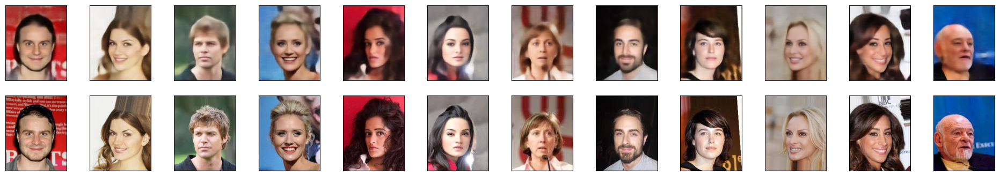

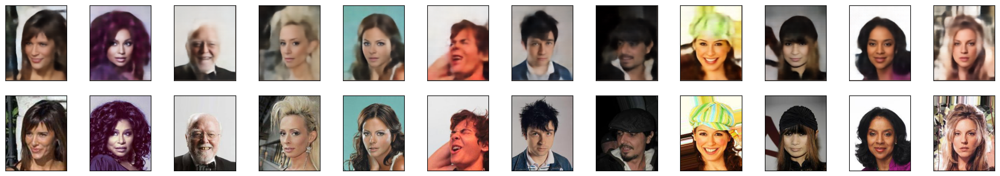

In [25]:
 plt.figure(figsize=(24,4))
for i in range(12):
    z = torch.clamp(plot_reconstructions[i],0,1)
    plt.subplot(2,12,i+1)
    plt.imshow(z.permute(1,2,0).detach().cpu())
    plt.xticks([])
    plt.yticks([])

    plt.subplot(2,12,i+13)
    plt.imshow(plot_inputs[i].permute(1,2,0).detach().cpu())
    plt.xticks([])
    plt.yticks([])
# plt.show()
plt.figure(figsize=(24,4))
for i in range(12,24):
    z = torch.clamp(plot_reconstructions[i],0,1)
    plt.subplot(2,12,i-11)
    plt.imshow(z.permute(1,2,0).detach().cpu())
    plt.xticks([])
    plt.yticks([])

    plt.subplot(2,12,i+1)
    plt.imshow(plot_inputs[i].permute(1,2,0).detach().cpu())
    plt.xticks([])
    plt.yticks([])
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

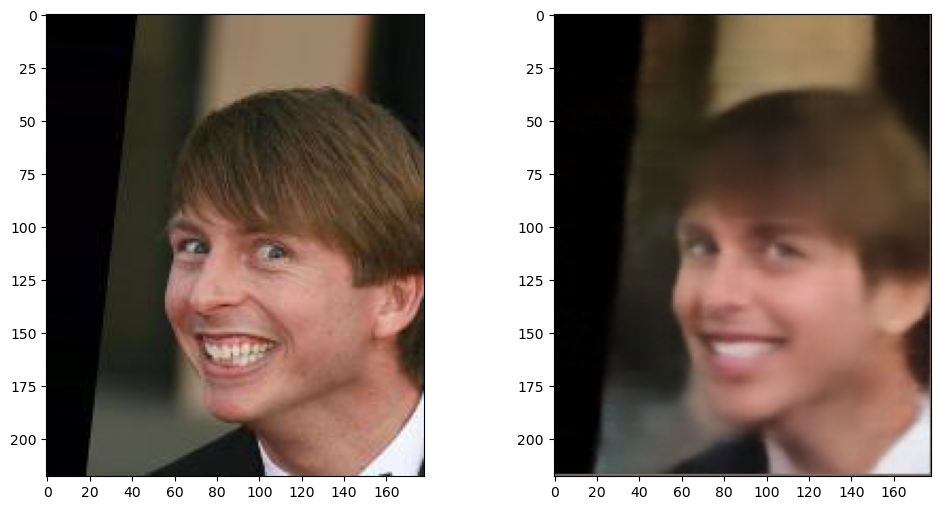

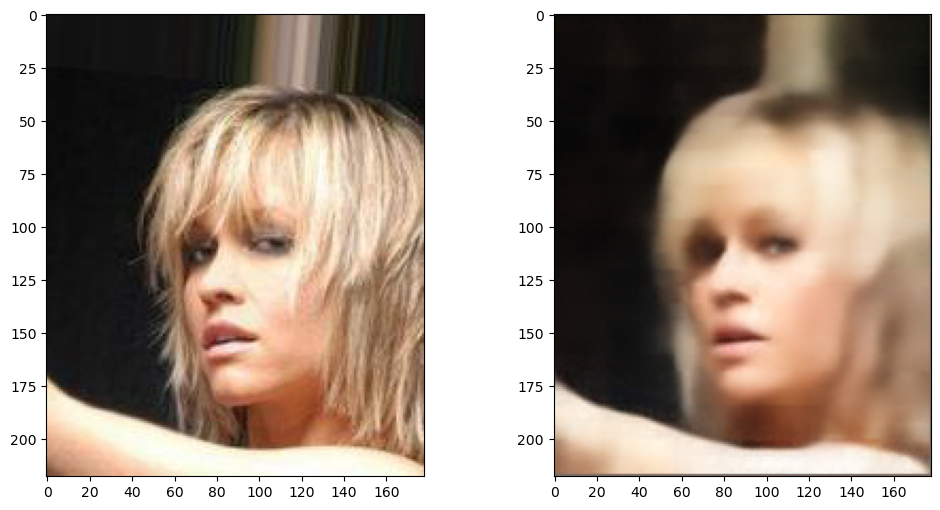

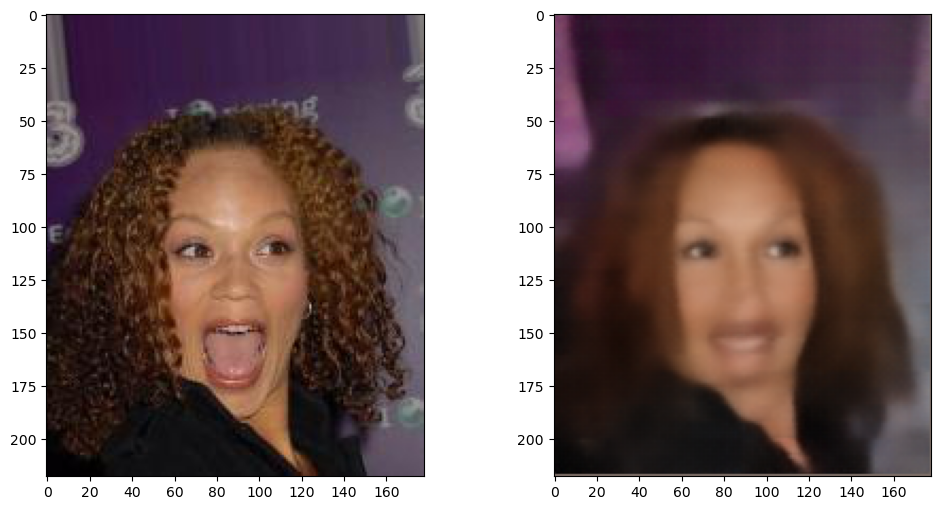

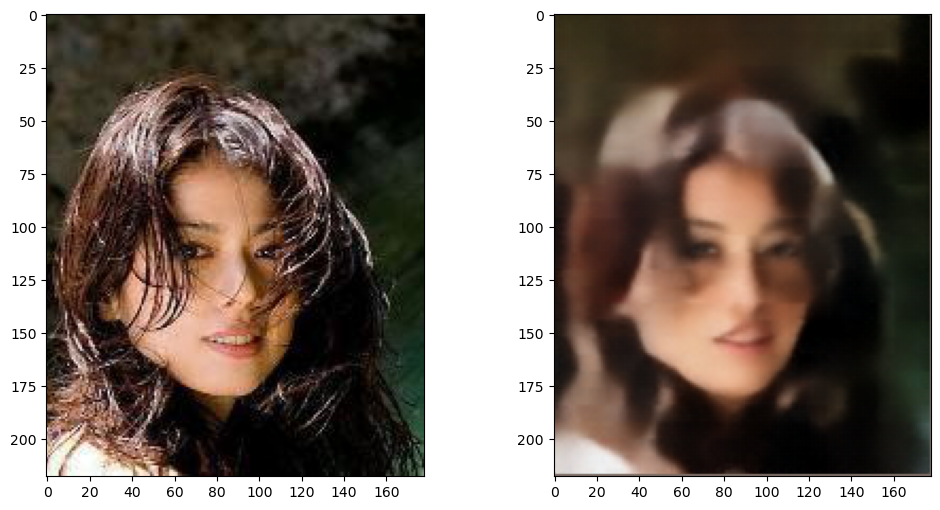

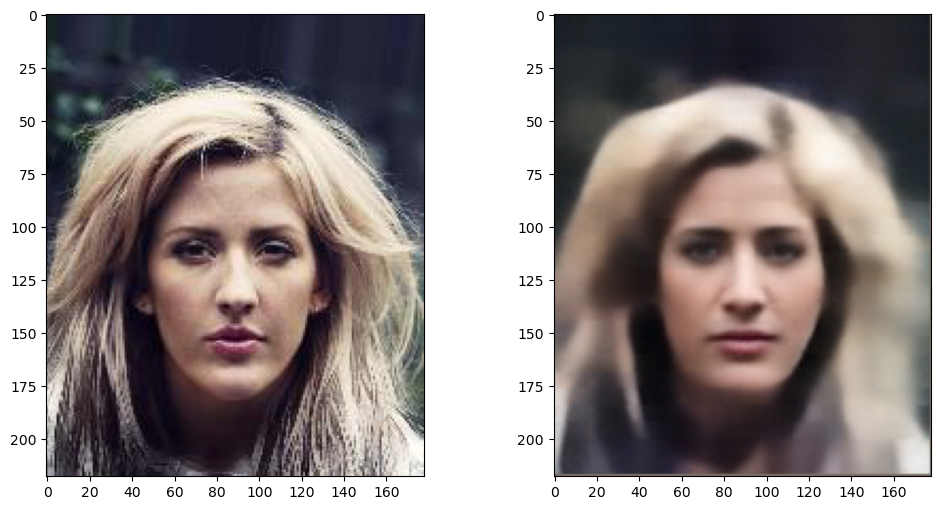

...

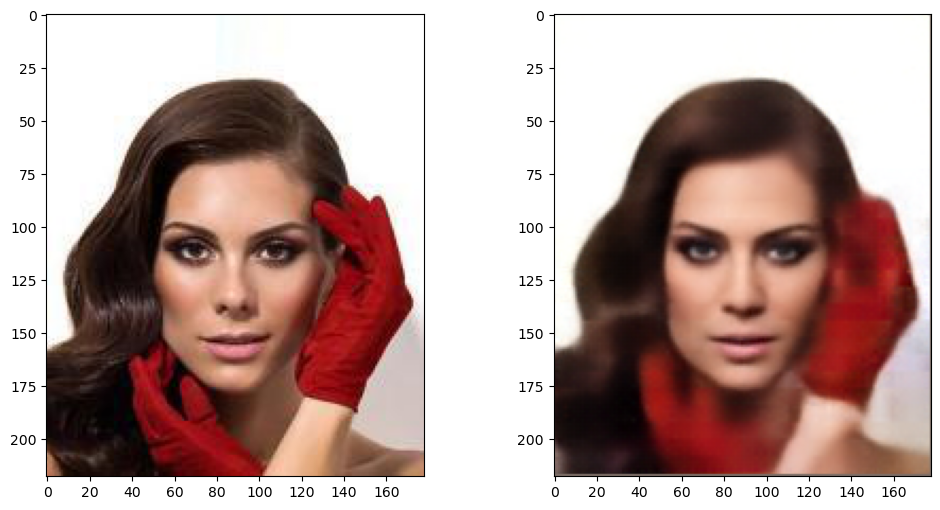

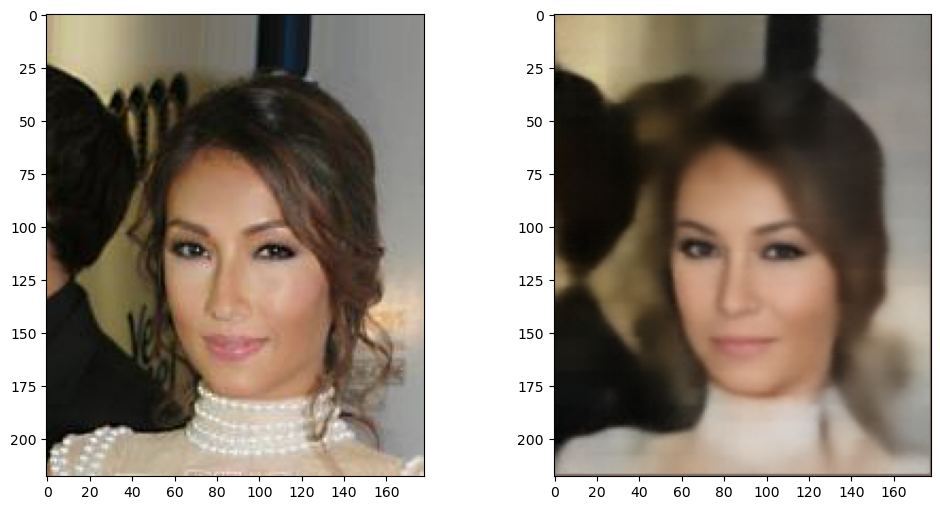

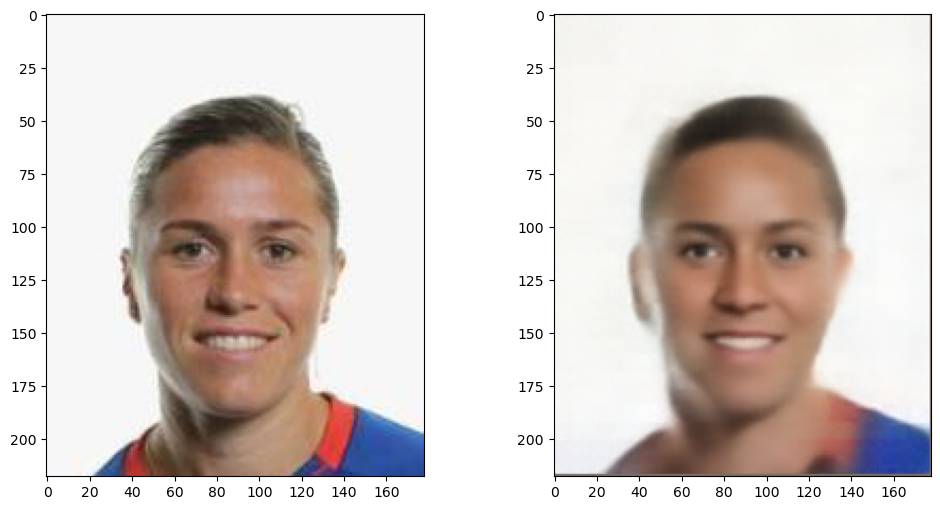

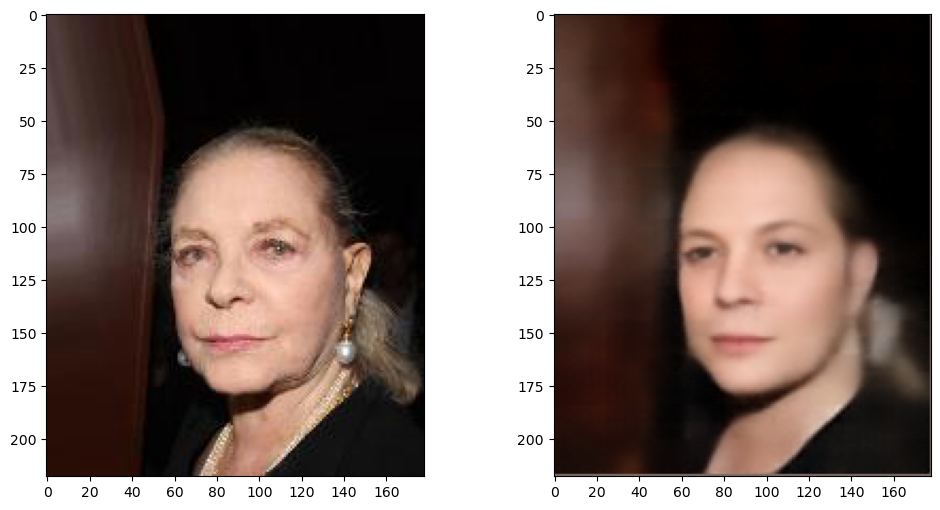

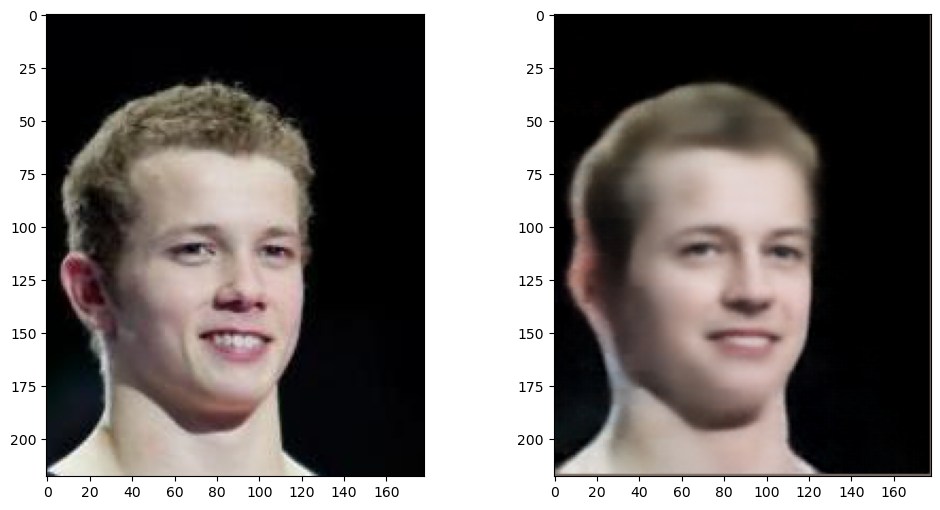

In [38]:
x = next(iter(train_loader))

for i in range(64):
    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.imshow(x[i].permute(1,2,0).numpy())

    plt.subplot(1,2,2)
    y=model(x.to(device))[i].permute(1,2,0).detach().cpu().numpy()
    z = torch.clamp(y,0,1)
    plt.imshow(z)

In [140]:
import ot

N=4000
d=512

train_loader2 = DataLoader(dataset, batch_size=N, shuffle=True)

batch_temp = next(iter(train_loader2))

model2 = model.to('cpu')

Y = model2.encoder(batch_temp).reshape(N,d)
# X = model2.encoder(batch_data).reshape(N,d)
X = torch.randn_like(torch.zeros(N,d))

M=torch.cdist(X,Y)

a=(torch.ones(N)/N)
b=(torch.ones(N)/N)

In [ ]:
N=4000
d=512

a=(torch.ones(N)/N)
b=(torch.ones(N)/N)

train_loader2 = DataLoader(dataset, batch_size=N, shuffle=True)

X = torch.randn_like(torch.zeros(N,d))
X_update = torch.zeros(N,d)

for batch in train_loader2:
    
    Y = model2.encoder(batch).reshape(N,d)
    M=torch.cdist(X,Y)
    Pi = ot.sinkhorn(a,b,M,0.4)
    
    X_update += Pi@Y

1 

RuntimeError: [enforce fail at C:\cb\pytorch_1000000000000\work\c10\core\impl\alloc_cpu.cpp:72] data. DefaultCPUAllocator: not enough memory: you tried to allocate 465648 bytes.

In [ ]:
%%timeit
Pi = ot.emd(a,b,M)

1.75 s ± 8.88 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [195]:
%%timeit
A=torch.randn_like(torch.zeros(N,d))
B=torch.randn_like(torch.zeros(N,d))
M=torch.cdist(A,B)
ot.sinkhorn(a,b,M,0.4)

The slowest run took 4.97 times longer than the fastest. This could mean that an intermediate result is being cached.
8.43 s ± 5 s per loop (mean ± std. dev. of 7 runs, 1 loop each)
